# Fusion of Sentinel-1 and Sentinel-2 NDVI products

Combine a Sentinel-2 L2A NDVI product partly occulted by clouds with Sentinel-1 GRD observation to produce a seamless NDVI product, based on the relationship between radar backscatter and NDVI.

### _Import functional dependencies and add repository source directory to system path_

In [1]:
import os
import yaml
from munch import munchify

In [2]:
# define repo name and get root working directory
repo = 'process'
root_path = os.getcwd()[ 0 : os.getcwd().find( repo ) + len ( repo )]
root_path

'C:\\Users\\crwil\\Documents\\GitHub\\sentinelhub\\apis\\process'

In [3]:
# get path to configuration files
cfg_path = os.path.join( root_path, 'cfg' )
cfg_path = os.path.join( cfg_path, 'fusion' )
cfg_path

'C:\\Users\\crwil\\Documents\\GitHub\\sentinelhub\\apis\\process\\cfg\\fusion'

### _Load configuration file from repository cfg sub-directory_ 

In [4]:
# get pathname to configuration file
cfg_file = os.path.join( cfg_path, 's1s2-timeseries-ndvi.yml' )

In [5]:
# print contents of configuration file
with open( cfg_file ) as f:
    print ( f.read() )

request:
    evalscript: |
                //VERSION=3
                function setup() {
                    return {
                        input: [{
                            datasource: "s1",
                            bands: ["VV", "VH"]
                        },
                        {
                            datasource: "s2_l2a",
                            bands: ["B02", "B03", "B08", "B04", "SCL"]
                        } ],
                        output: [
                            { id: "TrueColor", bands: 3 },
                            { id: "VV", bands: 1 },
                            { id: "NDVI", bands: 3 },
                            { id: "SCL", bands: 1, sampleType: SampleType.UINT16 } ]
                    }
                }
                function toDb(linear) {
                // Convert the linear backscatter to DB (Filgueiras et al. (2019), eq. 3)
                    return 10 * Math.LN10 * linear
                }
                function ca

In [6]:
# load cfg file using yaml parser
with open( cfg_file, 'r' ) as f:
    config = munchify( yaml.safe_load( f ) )

### _Define bounding box collated with the Mendip Hills in Somerset_

In [7]:
# setup aoi limits and resolution
coords = -2.738455,51.193657,-2.504883,51.367500
resolution = 10

In [8]:
# create instance of shclient class
from processapi import Client
client = Client( config )

In [9]:
# get utm bbox
bbox = client.getBoundingBox( coords, dst_crs=27700 )
print ( bbox, bbox.crs.value )

348494.2087206844,144085.589638895,364948.80409136787,163280.85921708145 27700


In [10]:
# get aoi image dimensions
client.getBoxDimensions( bbox, resolution )

(1619, 1942)

### _Use Catalog API to locate coincident scenes acquired early February 2021_

In [11]:
# pick a few dates
from datetime import datetime
timeframe = { 'start' : datetime( 2021, 6, 5, 0, 0, 0 ), 
                'end' : datetime( 2021, 6, 8, 23, 59, 59 ) }

In [12]:
# get S2 acquisitions between start / end dates satisfying filter conditions
client.getDatasetTimeStamps ( config.request.inputs[ 0 ], bbox, timeframe )

[datetime.datetime(2021, 6, 5, 11, 16, 53, tzinfo=tzutc()),
 datetime.datetime(2021, 6, 8, 11, 26, 50, tzinfo=tzutc())]

In [13]:
# get S1 acquisitions between start / end dates 
client.getDatasetTimeStamps ( config.request.inputs[ 1 ], bbox, timeframe )

[datetime.datetime(2021, 6, 5, 6, 23, 15, tzinfo=tzutc()),
 datetime.datetime(2021, 6, 7, 18, 5, 12, tzinfo=tzutc()),
 datetime.datetime(2021, 6, 8, 17, 57, 43, tzinfo=tzutc())]

### _Download image time series from Sentinel Hub collocated with bounding box and timeframe_

In [14]:
# get time series
response = client.getTimeSeries ( bbox, timeframe, resolution )
response._df

,TrueColor.tif,VV.tif,NDVI.tif,SCL.tif,time
0,"[[[39, 20, 14], [39, 20, 15], [37, 19, 14], [2...","[[14, 20, 17, 7, 20, 14, 2, 9, 18, 28, 35, 27,...","[[[215, 48, 39], [215, 48, 39], [244, 109, 67]...","[[5, 5, 5, 5, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,...",2021-06-05 11:16:53+00:00
1,"[[[36, 22, 17], [36, 23, 18], [38, 24, 19], [3...","[[14, 20, 17, 7, 20, 14, 2, 9, 18, 28, 35, 27,...","[[[217, 239, 139], [102, 189, 99], [244, 109, ...","[[10, 10, 10, 10, 10, 10, 10, 10, 10, 10, 10, ...",2021-06-08 11:26:50+00:00


In [15]:
# construct binary cloud mask
import numpy as np
response._df[ 'cloud_mask' ] = response._df[ 'SCL.tif' ].apply( lambda x: np.logical_and( x >= 7, x <= 10 ) )

### _Visualise Sentinel-2 True Color image time series_ 

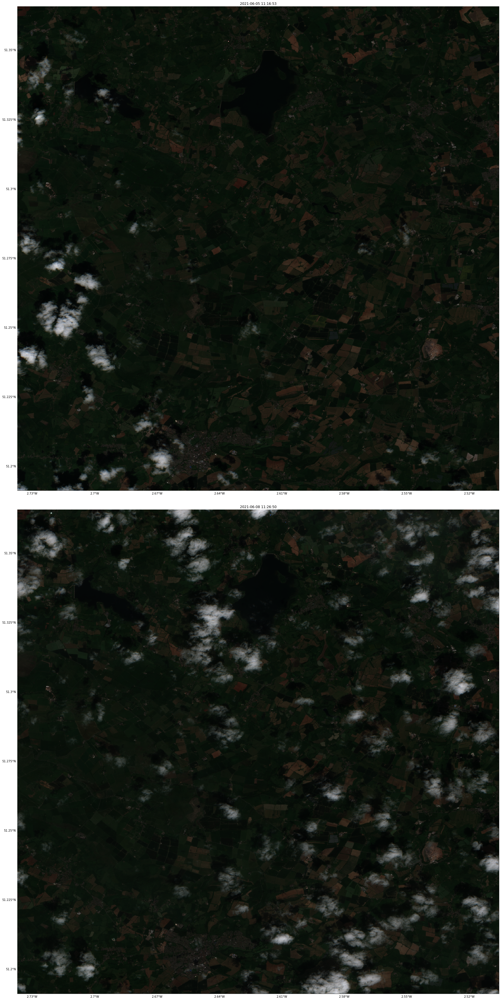

In [16]:
response.plotImages( 'TrueColor.tif', alpha={ 'data' : 1.0, 'grid' : 0.0 } )

### _Visualise Sentinel-1 VV Gamma 0 backscatter image time series_

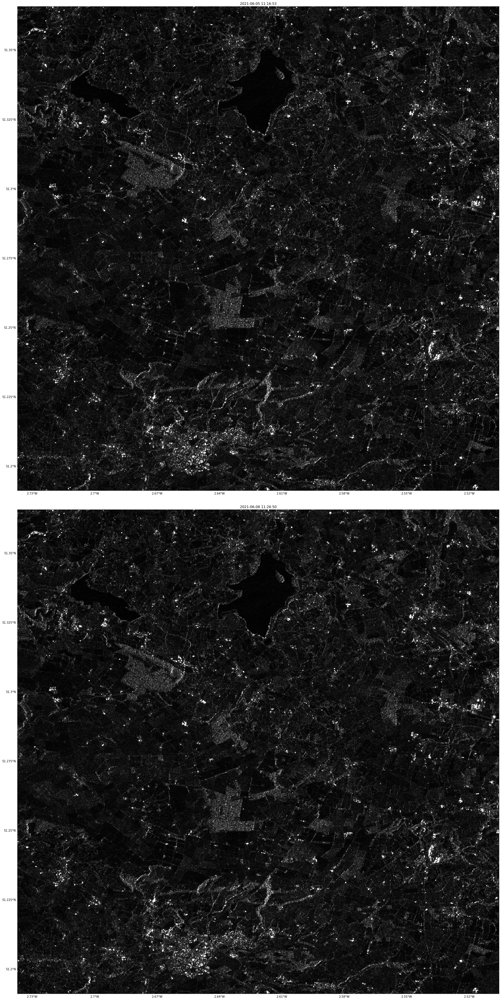

In [17]:
response.plotImages( 'VV.tif', alpha={ 'data' : 1.0, 'grid' : 0.0 }, cmap='gray' )

### _Visualise Sentinel-2 Scene Classification image time series_

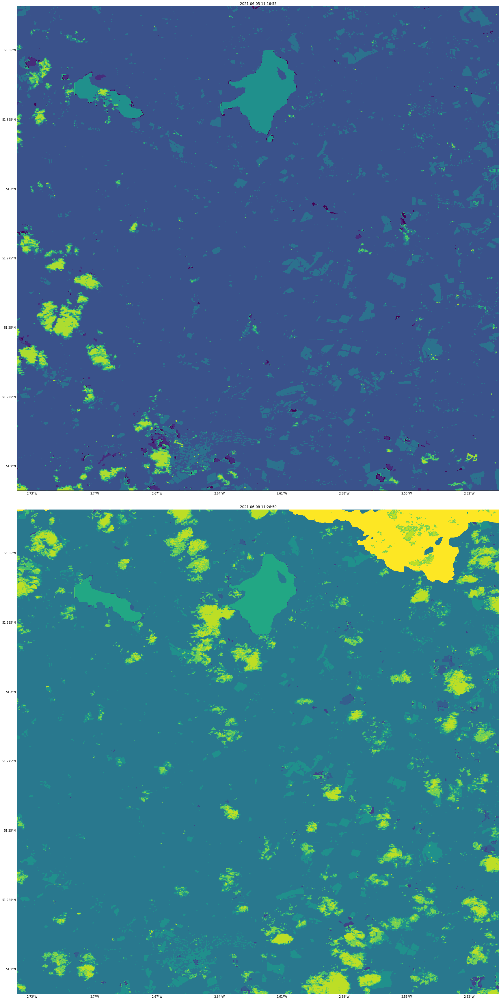

In [18]:
response.plotImages( 'SCL.tif', alpha={ 'data' : 1.0, 'grid' : 0.0 } )

### _Visualise binary Cloud Mask derived from Scene Classification time series_

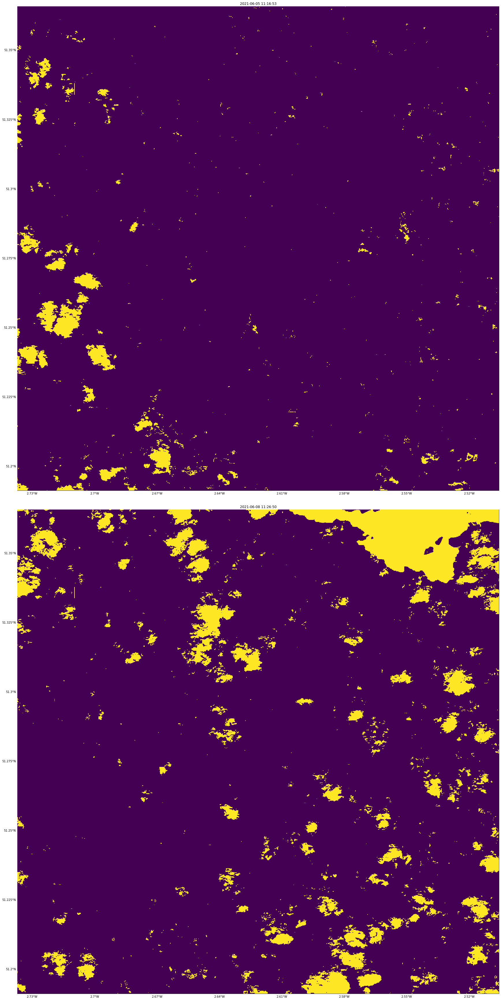

In [19]:
response.plotImages( 'cloud_mask', alpha={ 'data' : 1.0, 'grid' : 0.0 } )

### _Visualise fusion of Sentinel-2 and Sentinel-1 NDVI time series_ 

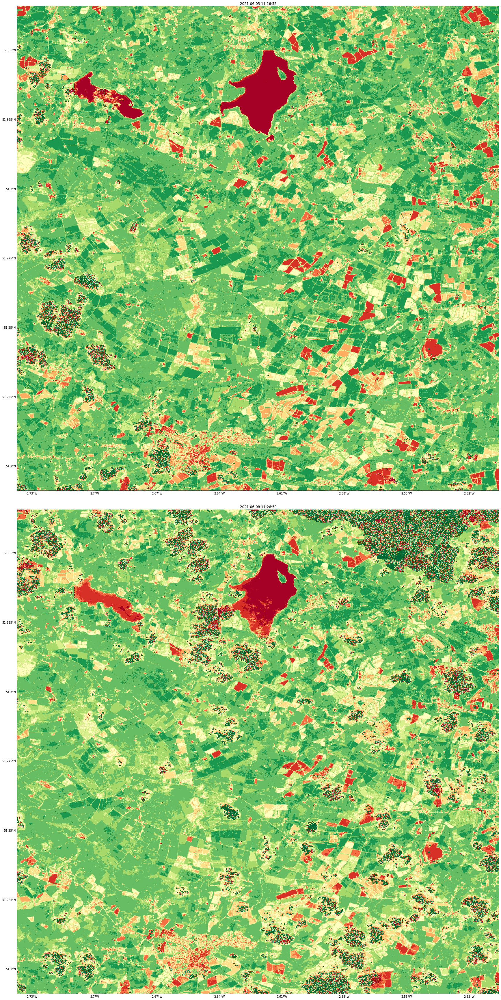

In [20]:
response.plotImages( 'NDVI.tif', alpha={ 'data' : 1.0, 'grid' : 0.0 } )